['64chlocs.elp', 'AP-128-X2.bvef', 'figures', 'figures.zip', 'label_extraction.npy', 'label_extraction.pkl', 'logistic_model.pkl', 'No_Pgr_montage.mtg', 'pineline 13.csv', 'pipe line 10', 'pipe line 10.csv', 'pipeline 13.pickle', 's5d2_final_annotations.txt', 's6n2_final_annotations.txt', 'single subject prediction.p', 'single subject test result.p', 'single subject testing.p', 'single subject.p', 'Sleep Stage Scoring Criteria.docx', 'spindle training.p', 'suj10_d1final_annotations.txt', 'suj10_d1_nap.eeg', 'suj10_d1_nap.vhdr', 'suj10_d1_nap.vmrk', 'suj10_d2final_annotations.txt', 'suj10_d2_nap.eeg', 'suj10_d2_nap.vhdr', 'suj10_d2_nap.vmrk', 'suj13_l2nap_day2.eeg', 'suj13_l2nap_day2.vhdr', 'suj13_l2nap_day2.vmrk', 'suj13_l5nap_day1.eeg', 'suj13_l5nap_day1.vhdr', 'suj13_l5nap_day1.vmrk', 'suj20_l2nap_day2.eeg', 'suj20_l2nap_day2.vhdr', 'suj20_l2nap_day2.vmrk', 'suj5_d1final_annotations.txt', 'suj5_d2_nap.eeg', 'suj5_d2_nap.vhdr', 'suj5_d2_nap.vmrk', 'suj6_d1final_annotations.txt', 'suj6

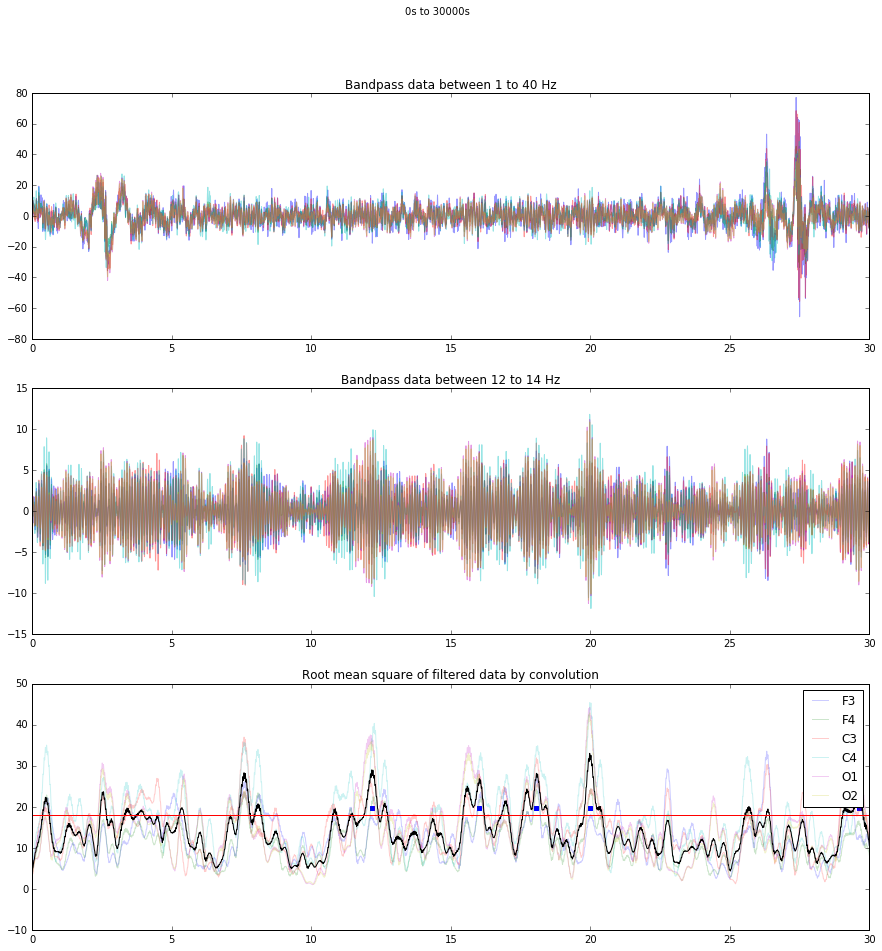

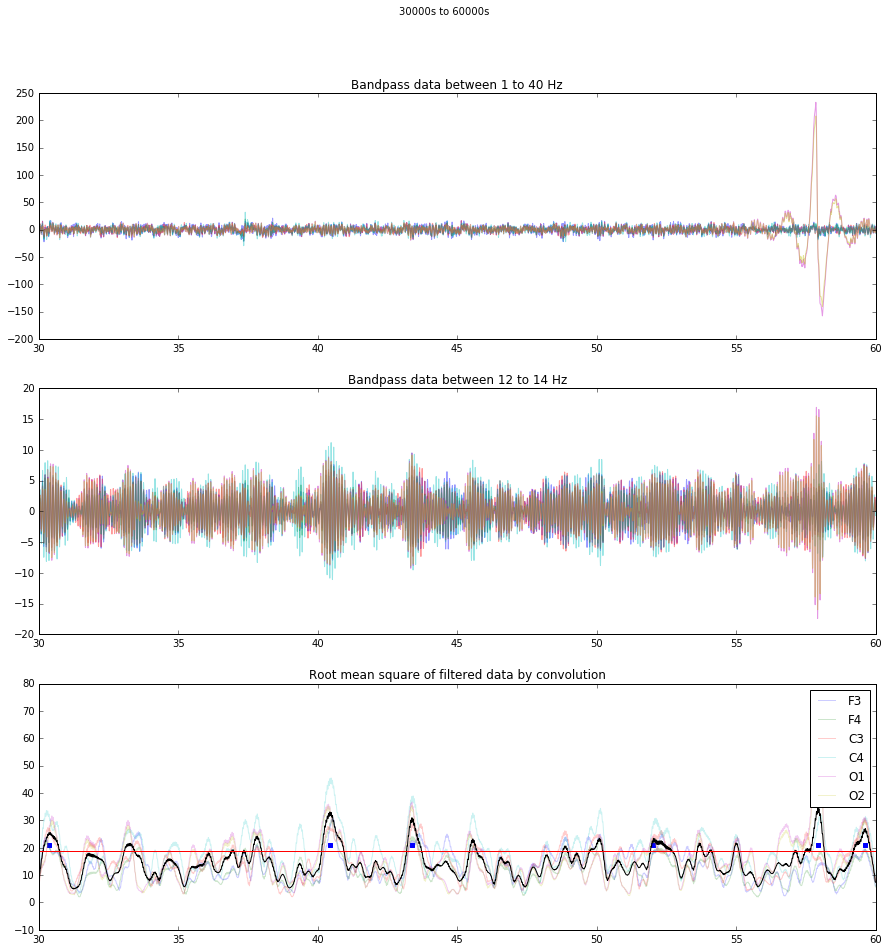

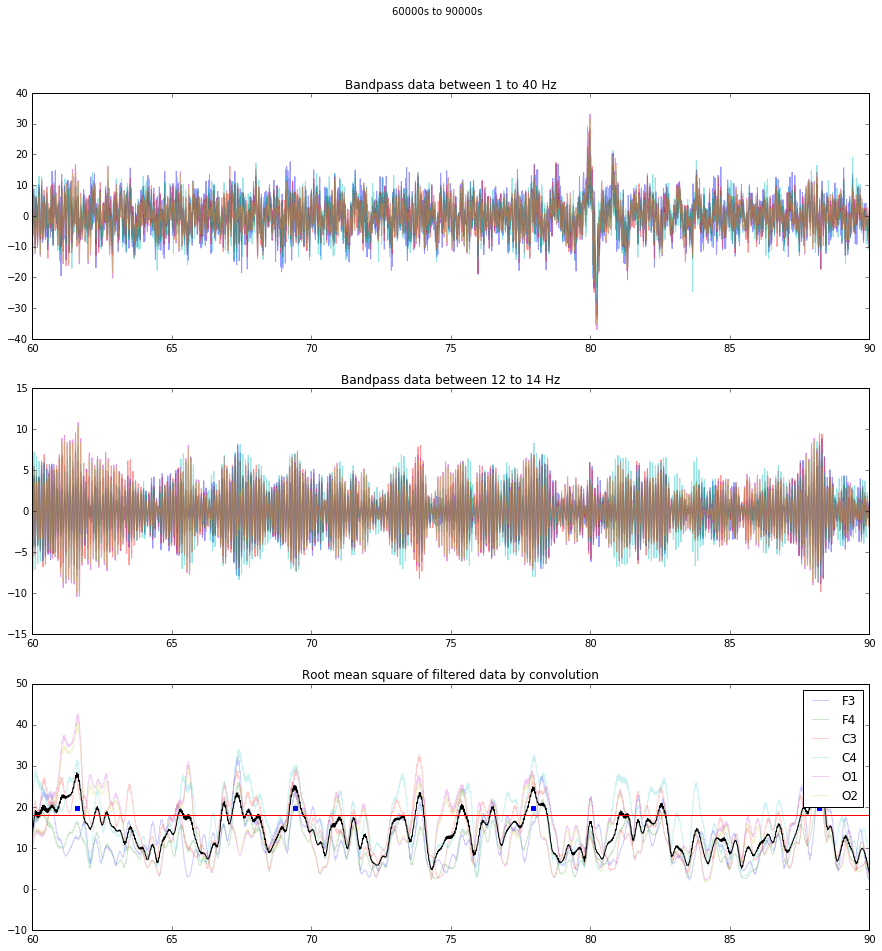

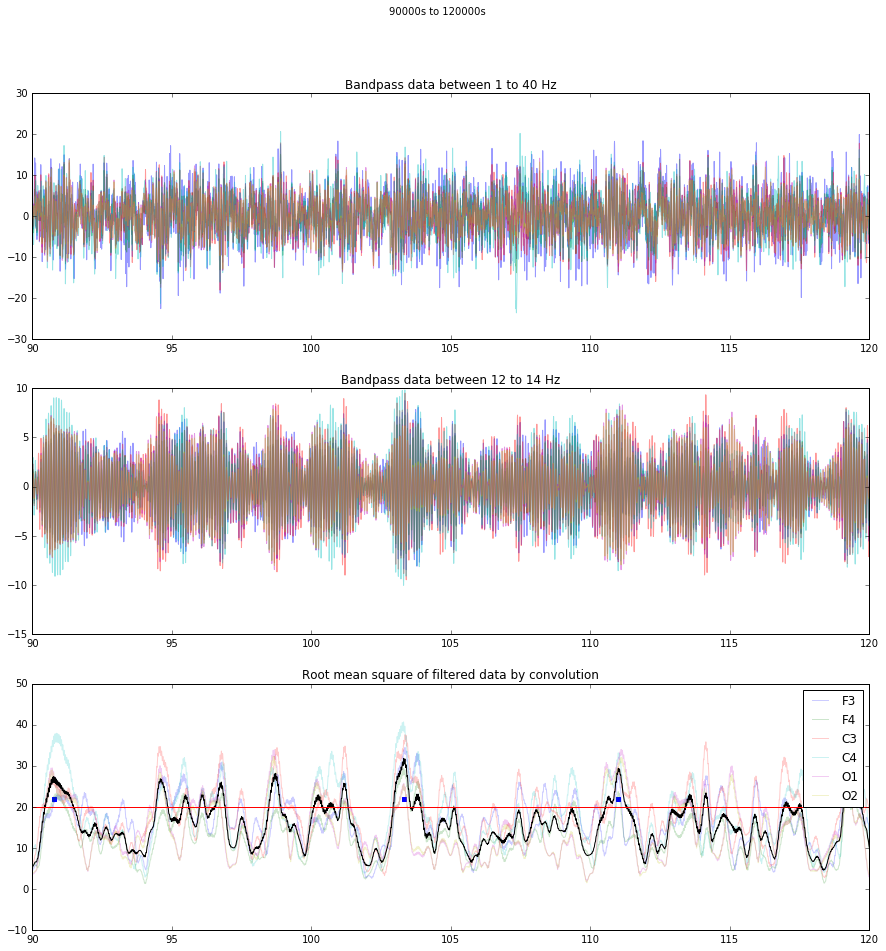

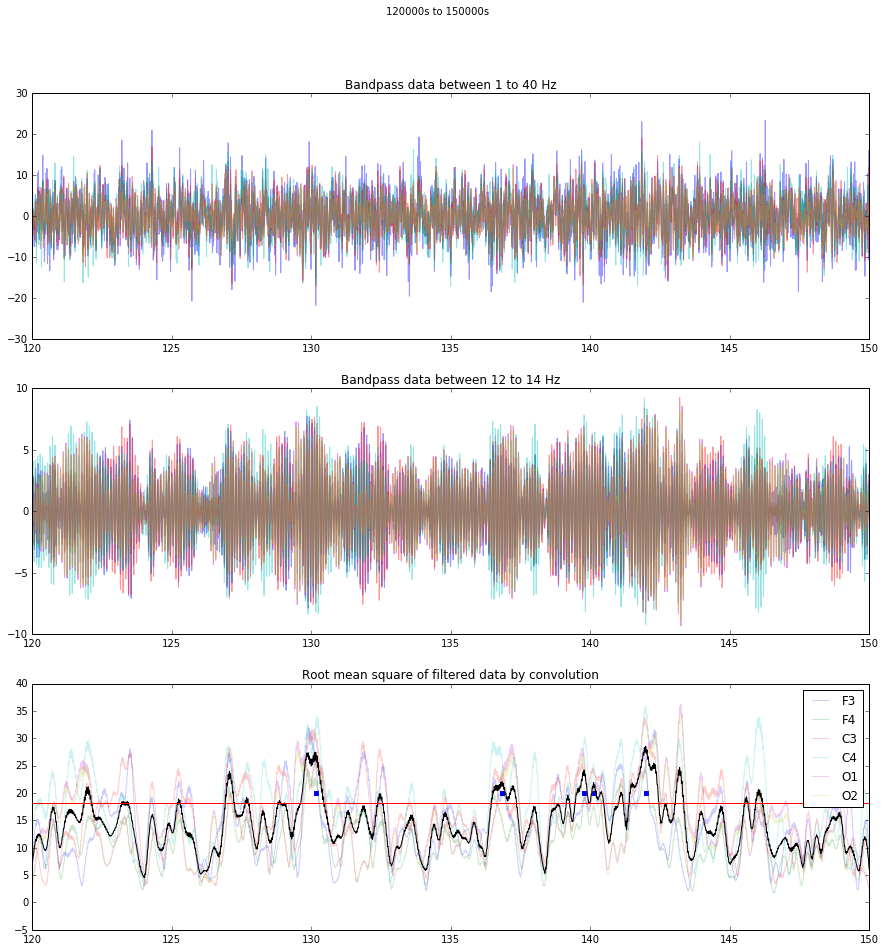

...

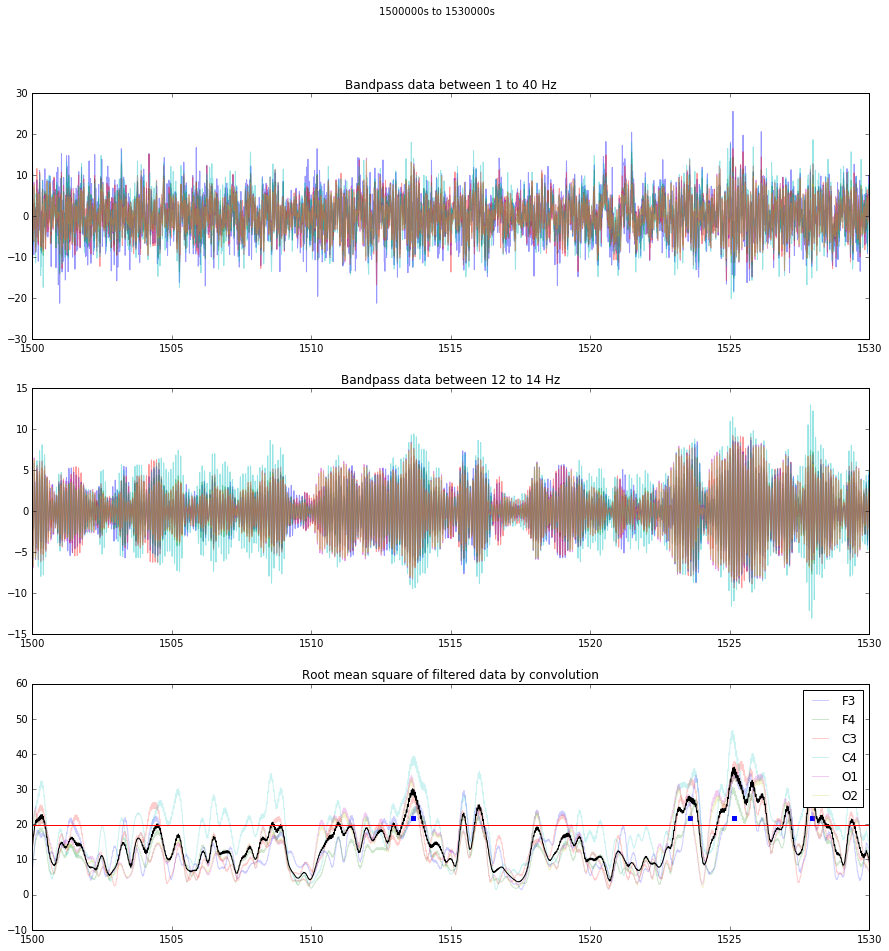

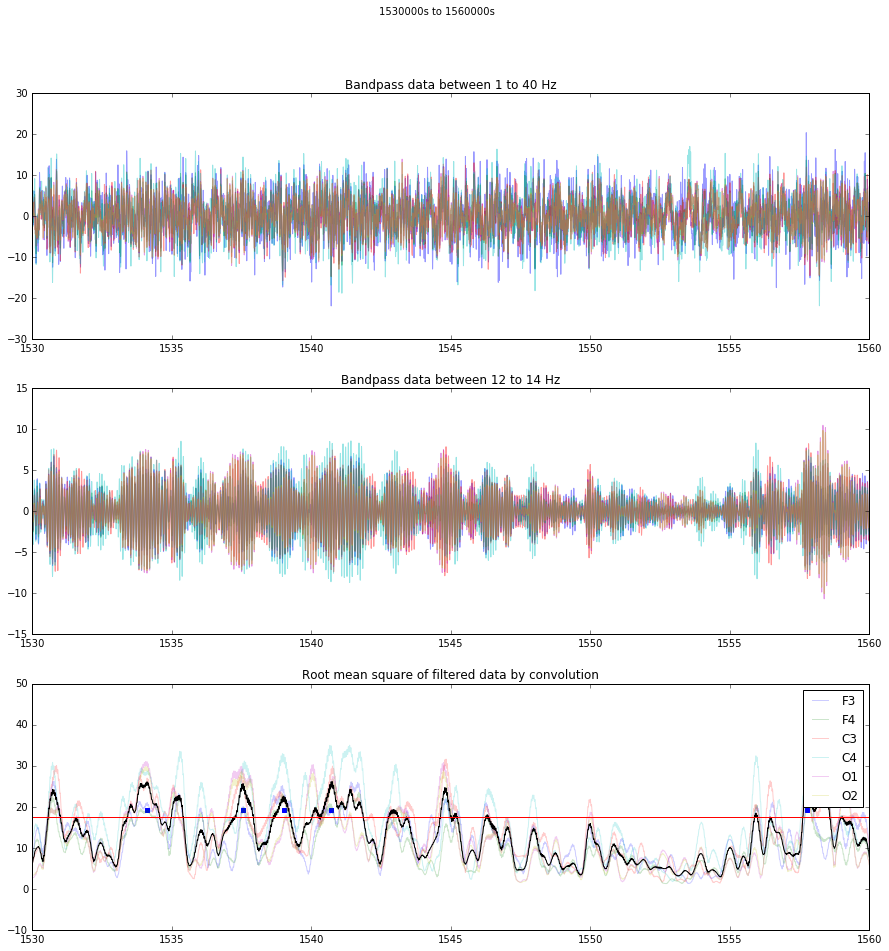

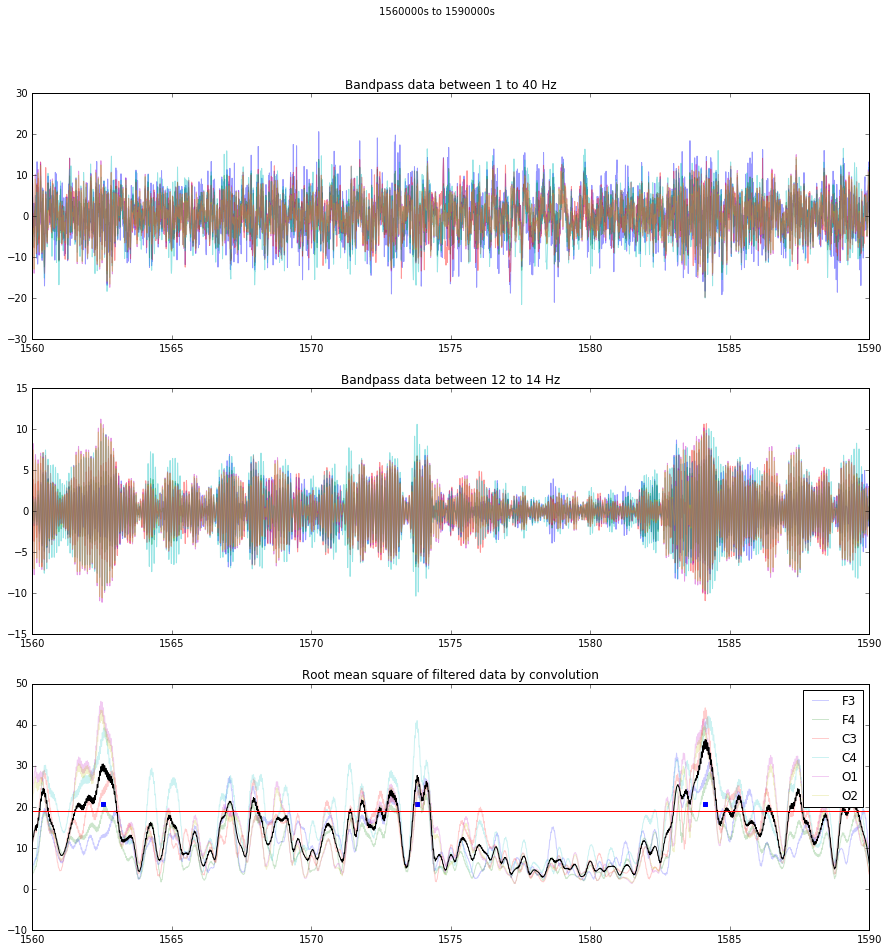

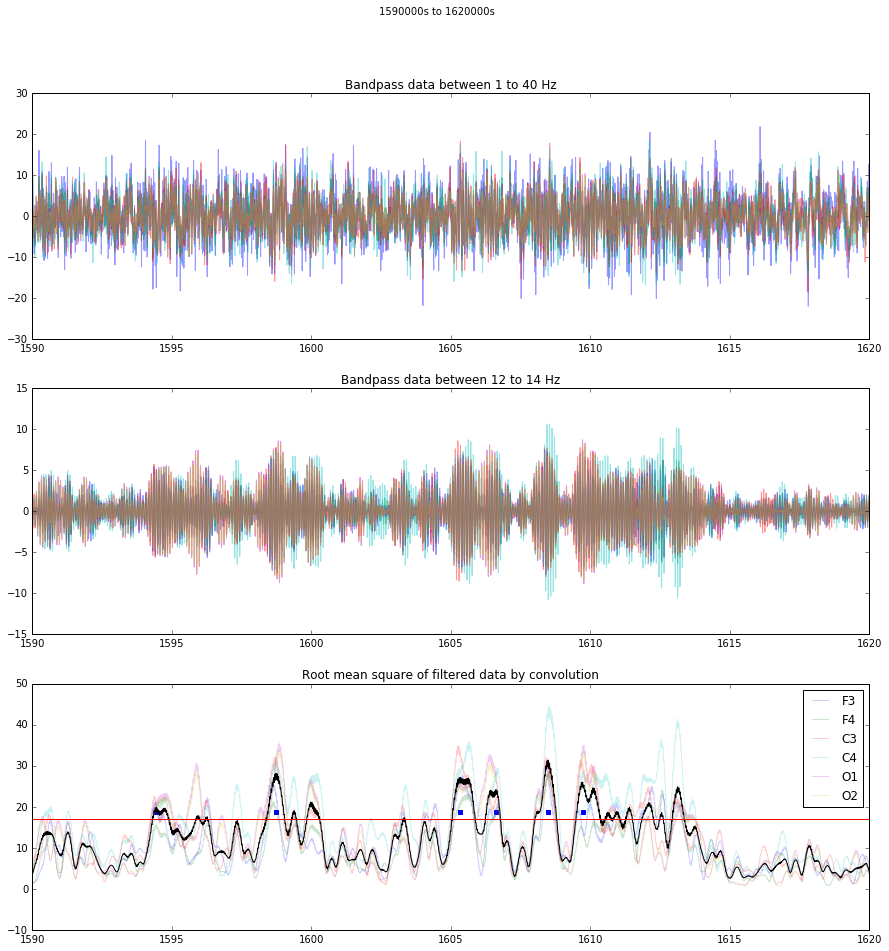

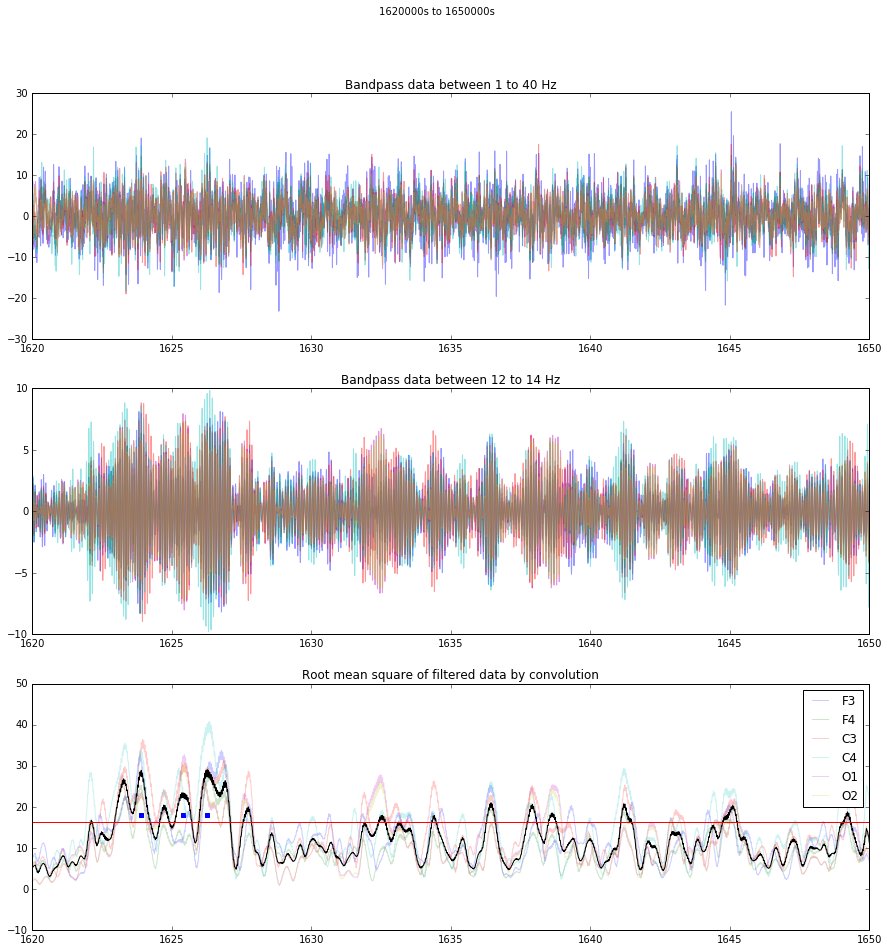

In [2]:
import eegPinelineDesign
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")
import mne




try:
    eegPinelineDesign.change_file_directory('C:/Users/ning/Downloads/training set')
except:
    pass
EDFfiles, Annotationfiles = eegPinelineDesign.split_type_of_files()

file_to_read='suj13_l2nap_day2.vhdr'
channelList = ['F3','F4','C3','C4','O1','O2','LOc', 'ROc']
raw = eegPinelineDesign.load_data(file_to_read,channelList,1,40)
# select channels of interests
channelList = ['F3','F4','C3','C4','O1','O2']
raw.pick_channels(channelList)
#raw_narrow.plot_psd(fmax=30,tmin=200,tmax=2000)


epochs = np.arange(0,raw.last_samp,30*1000)
epochSegment={};RMS={};peak_time=[];
for epch in range(len(epochs)-6):
    start,stop = (epochs[epch],epochs[epch+1])
    epochSegment[epch]=[]
    RMS[epch]=[]
    temp=[];temp2=[]
    fig=plt.figure(epch+1)
    fig.suptitle(str(epochs[epch])+'s to '+str(epochs[epch+1])+'s')
    fig.set_figheight(15)
    fig.set_figwidth(15)
    ###########################################################################
    for iii,names in enumerate(channelList):
        tempSegment,tempTime = raw[iii,start:stop]
        filter_Segment = mne.filter.band_pass_filter(tempSegment[0,:],1000,10,14)
        #take filtered segments to a list
        temp.append(filter_Segment)
        ax1=plt.subplot(311)
        ax1.plot(tempTime,tempSegment[0,:],alpha=.4,label=names)
        ax1.set_title('Bandpass data between 1 to 40 Hz')
        ax2=plt.subplot(312)
        ax2.plot(tempTime,filter_Segment,alpha=.4,label=names)
        ax2.set_title('Bandpass data between 12 to 14 Hz')
        ax=plt.subplot(313)
        # convolve over 200 ms window over 30s of data
        RMS_Segment = eegPinelineDesign.window_rms(filter_Segment,200)
        temp2.append(RMS_Segment)
        ax.plot(tempTime,RMS_Segment,alpha=0.2,label=names)
        ax.set_title('Root mean square of filtered data by convolution')
    ###########################################################################
    ax.legend()
    epochSegment[epch]=np.array(temp)
    RMS[epch]=np.array(temp2)
    # temp data contains only 30s of data
    tempEpoch=np.array(temp)
    tempRMS=np.array(temp2)
    # calculate the means and standard deviation
    mean_tempEpoch=tempEpoch.mean(axis=0)
    mean_tempRMS=tempRMS.mean(axis=0)
    ax.plot(tempTime,mean_tempRMS,color='k')
    ax.set_xlim([tempTime[0],tempTime[-1]])
    # algorithm for peak search: 1-amplitude 2 - duration
    mph=mean_tempRMS.mean() + 0.8 * mean_tempRMS.std()
    ax.axhline(mph,color='r')
    pass_=mean_tempRMS > (mean_tempRMS.mean() + 0.8 * mean_tempRMS.std())
    up = np.where(np.diff(pass_.astype(int))>0)
    down = np.where(np.diff(pass_.astype(int))<0)
    if (up[0].shape > down[0].shape) or (up[0].shape < down[0].shape):
        size = np.min([up[0].shape,down[0].shape])
        up = up[0][:size]
        down = down[0][:size]
    C = np.vstack((up,down))
    for pairs in C.T:
        if 0.5 < (tempTime[pairs[1]] - tempTime[pairs[0]]) < 2.5:
            TimePoint = np.mean([tempTime[pairs[1]],tempTime[pairs[0]]])
            SegmentForPeakSearching = mean_tempRMS[pairs[0]:pairs[1]]
            temp_temp_time = tempTime[pairs[0]:pairs[1]]
            ints_temp = np.argmax(SegmentForPeakSearching)
            peak_time.append(temp_temp_time[ints_temp])
            ax.scatter(temp_temp_time[ints_temp],mph+0.1*mph,marker='s',color='blue')